## Instala o YOLOv7

In [ ]:
# Download YOLOv7 repository and install requirements
# %cd /content/drive/MyDrive/Global Drones/GD_PRF-YOLOv7_Test
!git clone https://github.com/WongKinYiu/yolov7
%cd ./yolov7
!pip install -r requirements.txt

: 

## Baixa o dataset do Roboflow para treinar

In [ ]:
# !pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="iKA9P5eUE0Kaej16Tg0e")
project = rf.workspace("mohammed-vo6ua").project("areial1")
dataset = project.version(4).download("yolov7")


: 

In [ ]:
print(dataset.location)

/content/drive/MyDrive/Global Drones/GD_PRF-YOLOv7_Test/yolov7/Areial1-4


## Treinamento

In [ ]:
%cd /content/drive/MyDrive/Global Drones/GD_PRF-YOLOv7_Test/yolov7
data_yaml_path = dataset.location + "/data.yaml"
!python train.py --batch 16 --epochs 55 --data '{data_yaml_path}' --weights 'yolov7.pt' --device 0


/content/drive/MyDrive/Global Drones/GD_PRF-YOLOv7_Test/yolov7
2023-10-10 20:09:29.259368: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-10-10 20:09:30.183580: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
YOLOR 🚀 2023-10-10 torch 2.0.1+cu118 CUDA:0 (Tesla T4, 15101.8125MB)

Namespace(weights='runs/train/exp/weights/last.pt', cfg='', data='/content/drive/MyDrive/Global Drones/GD_PRF-YOLOv7_Test/yolov7/Areial1-4/data.yaml', hyp='data/hyp.scratch.p5.yaml', epochs=55, batch_size=16, img_size=[640, 640], rect=False, resume=False, nosave=False, notest=False, noautoanchor=False, evolve=False, bucket='', cache_images=False, image_weights=False, device='0', multi_scale=False, single_cls=False, adam=False, 

## Avaliação

In [ ]:
%cd /content/drive/MyDrive/Global Drones/GD_PRF-YOLOv7_Test/yolov7
valid_images_path = dataset.location + "/valid/images"

!python detect.py --weights runs/train/exp6/weights/best.pt --conf 0.1 --source '{valid_images_path}'


/content/drive/MyDrive/Global Drones/GD_PRF-YOLOv7_Test/yolov7
Namespace(weights=['runs/train/exp6/weights/best.pt'], source='/content/Areial1-4/valid/images', img_size=640, conf_thres=0.1, iou_thres=0.45, device='', view_img=False, save_txt=False, save_conf=False, nosave=False, classes=None, agnostic_nms=False, augment=False, update=False, project='runs/detect', name='exp', exist_ok=False, no_trace=False)
YOLOR 🚀 2023-10-10 torch 2.0.1+cu118 CUDA:0 (Tesla T4, 15101.8125MB)

Fusing layers... 
RepConv.fuse_repvgg_block
RepConv.fuse_repvgg_block
RepConv.fuse_repvgg_block
Model Summary: 306 layers, 36528391 parameters, 6194944 gradients
 Convert model to Traced-model... 
 traced_script_module saved! 
 model is traced! 

/usr/local/lib/python3.10/dist-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, *

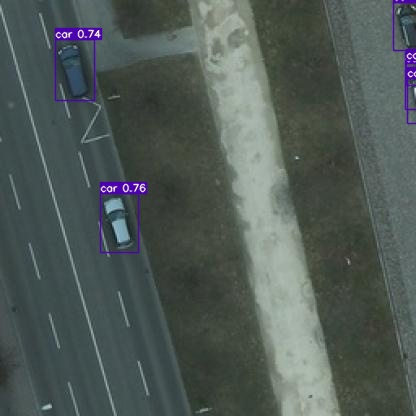

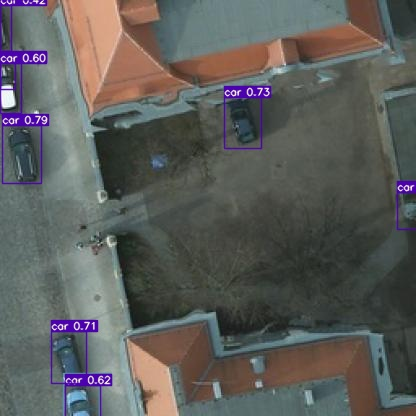

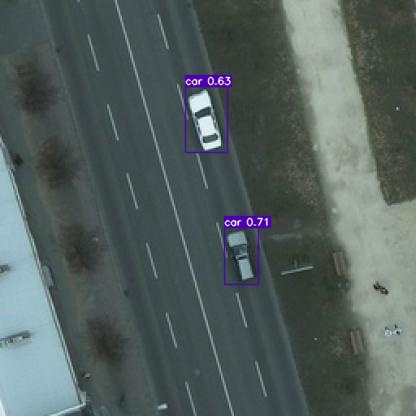

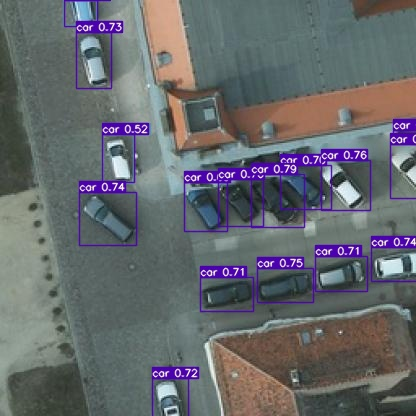

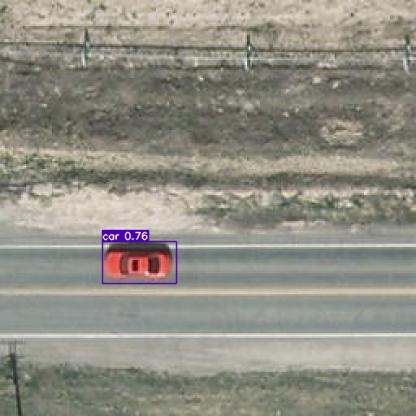

...

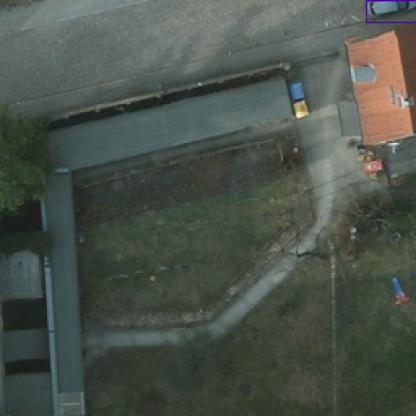

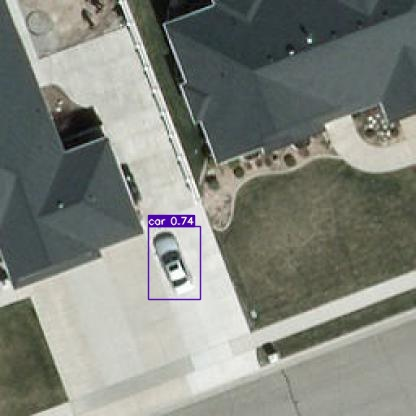

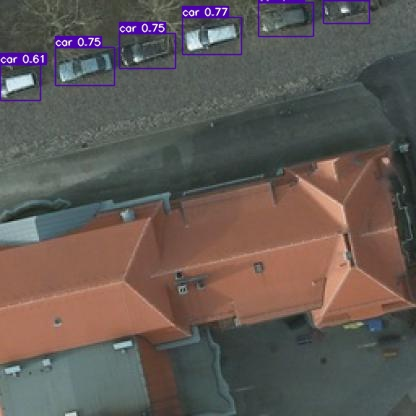

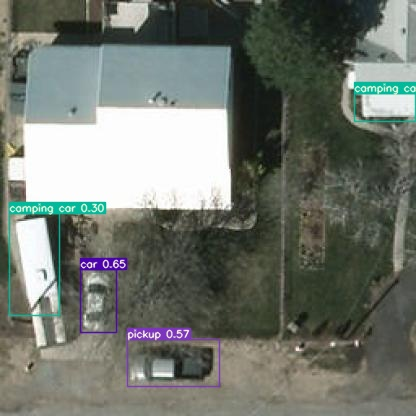

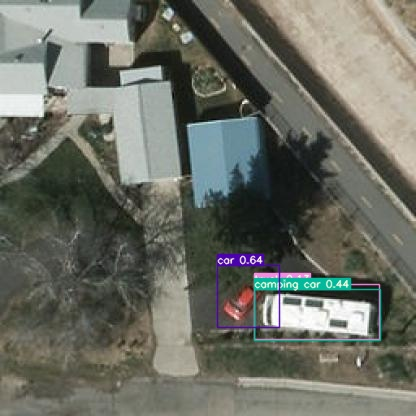

In [ ]:
#display inference on ALL test images

import glob
from IPython.display import Image, display

i = 0
limit = 10000 # max images to print
for imageName in glob.glob('/content/drive/MyDrive/Global Drones/GD_PRF-YOLOv7_Test/yolov7/runs/detect/exp/*.jpg'): #assuming JPG
    if i < limit:
      display(Image(filename=imageName))
      print("\n")
    i = i + 1
